In [1]:
import os

In [2]:
CUSTOM_MODEL_NAME = 'my_ssd_mobnet' 
PRETRAINED_MODEL_NAME = 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8'
PRETRAINED_MODEL_URL = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz'
TF_RECORD_SCRIPT_NAME = 'generate_tfrecord.py'
LABEL_MAP_NAME = 'label_map.pbtxt'

In [3]:
!pwd

/content


In [4]:
!pip install tensorflow==2.8

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 462 kB 12.9 MB/s 


In [5]:
!pip install opencv-python-headless==4.1.2.30

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 21.8 MB 1.5 MB/s 


In [6]:
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following packages will be REMOVED:
  libcudnn8-dev
The following held packages will be changed:
  libcudnn8
The following packages will be upgraded:
  libcudnn8
1 upgraded, 0 newly installed, 1 to remove and 40 not upgraded.
Need to get 430 MB of archives.
After this operation, 3,139 MB disk space will be freed.
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  libcudnn8 8.1.0.77-1+cuda11.2 [430 MB]
Fetched 430 MB in 8s (51.2 MB/s)
(Reading database ... 155629 files and directories currently installed.)
Removing libcudnn8-dev (8.0.5.39-1+cuda11.1) ...
(Reading database ... 155607 files and directories currently installed.)
Preparing to unpack .../libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb ...
Unpacking libcudnn8 (8.1.0.77-1+c

In [7]:
# !pip uninstall protobuf matplotlib -y
# !pip install matplotlib==3.2
# !pip install protobuf==3.20

# Downlod TF Pretrained Model from tensorflow Zoo

In [8]:
if not os.path.exists("models"):
  !git clone https://github.com/tensorflow/models 

Cloning into 'models'...
remote: Enumerating objects: 73195, done.
remote: Counting objects: 100% (98/98), done.
remote: Compressing objects: 100% (46/46), done.
remote: Total 73195 (delta 54), reused 91 (delta 49), pack-reused 73097
Receiving objects: 100% (73195/73195), 579.33 MiB | 31.87 MiB/s, done.
Resolving deltas: 100% (51833/51833), done.


In [9]:
os.chdir('./models/research/')
!protoc object_detection/protos/*.proto --python_out=.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
     |████████████████████████████████| 10.3 MB 40.3 MB/s 
     |████████████████████████████████| 352 kB 59.4 MB/s 
     |████████████████████████████████| 2.1 MB 63.7 MB/s 
     |████████████████████████████████| 25.9 MB 1.6 MB/s 
     |████████████████████████████████| 67 kB 8.0 MB/s 
     |████████████████████████████████| 99 kB 12.4 MB/s 
     |████████████████████████████████| 4.6 MB 56.8 MB/s 
     |████████████████████████████████| 1.1 MB 58.9 MB/s 
     |█

In [10]:
!wget https://raw.githubusercontent.com/neirinzaralwin/Deep-Learning/main/Neural%20Networks/SSD%20Mobile%20Net/Car%20License%20Plate%20Detection/generate_tfrecord.py

--2022-05-30 06:51:25--  https://raw.githubusercontent.com/neirinzaralwin/Deep-Learning/main/Neural%20Networks/SSD%20Mobile%20Net/Car%20License%20Plate%20Detection/generate_tfrecord.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3394 (3.3K) [text/plain]
Saving to: ‘generate_tfrecord.py’

generate_tfrecord.p 100%[===================>]   3.31K  --.-KB/s    in 0s      

2022-05-30 06:51:25 (49.5 MB/s) - ‘generate_tfrecord.py’ saved [3394/3394]



In [11]:
!python ./object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.7.13: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2022-05-30 06:51:31.377166: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W0530 06:51:31.850662 140075546908544 model_builder.py:1102] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 2.51s
I0530 06:51:32.595979 140075546908544 test_util.py:2459] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 2.51s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 1.1s
I0530 06:51:33.693096 140075546908544 test_ut

In [12]:
# !git clone https://github.com/nicknochnack/GenerateTFRecord

In [13]:
# import shutil

# shutil.move('./GenerateTFRecord/generate_tfrecord.py','generate_tfrecord.py')

In [14]:
!wget {PRETRAINED_MODEL_URL}
!tar -xf ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz

--2022-05-30 06:52:02--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.188.208, 2607:f8b0:4004:836::2010
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.188.208|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20518283 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.57M  --.-KB/s    in 0.1s    

2022-05-30 06:52:02 (206 MB/s) - ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz’ saved [20518283/20518283]



# Download Dataset

In [15]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))
  
# Then move kaggle.json into the folder where the API expects to find it.
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 70 bytes


In [16]:
%cd /content/models/research/

/content


In [17]:
!rm -rf './car-plate-detection'

In [18]:
!mkdir './car-plate-detection'
!mkdir './car-plate-detection/data/'

In [19]:
os.chdir('./car-plate-detection/data/')

In [20]:
!kaggle datasets download -d andrewmvd/car-plate-detection

 98% 199M/203M [00:01<00:00, 222MB/s]
100% 203M/203M [00:01<00:00, 199MB/s]


In [21]:
!unzip car-plate-detection.zip

Archive:  car-plate-detection.zip
  inflating: annotations/Cars0.xml   
  inflating: annotations/Cars1.xml   
  inflating: annotations/Cars10.xml  
  inflating: annotations/Cars100.xml  
  inflating: annotations/Cars101.xml  
  inflating: annotations/Cars102.xml  
  inflating: annotations/Cars103.xml  
  inflating: annotations/Cars104.xml  
  inflating: annotations/Cars105.xml  
  inflating: annotations/Cars106.xml  
  inflating: annotations/Cars107.xml  
  inflating: annotations/Cars108.xml  
  inflating: annotations/Cars109.xml  
  inflating: annotations/Cars11.xml  
  inflating: annotations/Cars110.xml  
  inflating: annotations/Cars111.xml  
  inflating: annotations/Cars112.xml  
  inflating: annotations/Cars113.xml  
  inflating: annotations/Cars114.xml  
  inflating: annotations/Cars115.xml  
  inflating: annotations/Cars116.xml  
  inflating: annotations/Cars117.xml  
  inflating: annotations/Cars118.xml  
  inflating: annotations/Cars119.xml  
  inflating: annotations/Cars12.xm

In [22]:
!rm car-plate-detection.zip

In [23]:
!pwd

/content/models/research/car-plate-detection/data


In [24]:
%cd /content/models/research/

/content/models/research


In [25]:
# !dir /content/models/research/car-plate-detection/data/images/

# Reading the dataset

In [26]:
img_list = [] 
annot_list = []

for dirname, _, filenames in os.walk('/content/models/research/car-plate-detection/'):
    for filename in filenames:
        if os.path.join(dirname, filename)[-3:]!="xml":
            img_list.append(os.path.join(dirname, filename))
        else:
            annot_list.append(os.path.join(dirname, filename))
            
img_list.sort()
annot_list.sort()

In [27]:
%cat /content/models/research/car-plate-detection/data/annotations/Cars0.xml


<annotation>
    <folder>images</folder>
    <filename>Cars0.png</filename>
    <size>
        <width>500</width>
        <height>268</height>
        <depth>3</depth>
    </size>
    <segmented>0</segmented>
    <object>
        <name>licence</name>
        <pose>Unspecified</pose>
        <truncated>0</truncated>
        <occluded>0</occluded>
        <difficult>0</difficult>
        <bndbox>
            <xmin>226</xmin>
            <ymin>125</ymin>
            <xmax>419</xmax>
            <ymax>173</ymax>
        </bndbox>
    </object>
</annotation>

In [28]:
img_list[0]

'/content/models/research/car-plate-detection/data/images/Cars0.png'

# Data Preprocessing

In [29]:
%cd ./car-plate-detection/

/content/models/research/car-plate-detection


In [30]:
!rm -rf train
!rm -rf test

In [31]:
!mkdir train
!mkdir test

In [32]:
import cv2
from PIL import Image
import shutil
LENGHT = len(img_list)

In [33]:
for i in range(LENGHT):
  img_png = Image.open(img_list[i])
  img_png = img_png.convert('RGB')
  img_png.save(img_list[i][0:-4]+'.jpg','JPEG')
  os.remove(img_list[i])

In [34]:
import xml.etree.ElementTree as ET

# for i,xmlfile in enumerate(glob.glob(annot_list)):
for i in range(len(annot_list)):
  tree = ET.parse(annot_list[i])

  for fname in tree.iter('filename'):
    fname.text = annot_list[i].split('/')[-1][0:-4] + '.jpg'

  tree.write(annot_list[i])    

In [35]:
img_list = [] 
annot_list = []

for dirname, _, filenames in os.walk('/content/models/research/car-plate-detection/'):
    for filename in filenames:
        if os.path.join(dirname, filename)[-3:]!="xml":
            img_list.append(os.path.join(dirname, filename))
        else:
            annot_list.append(os.path.join(dirname, filename))
            
img_list.sort()
annot_list.sort()

In [36]:
for i in range(LENGHT):

  if i < 400:
    shutil.move(img_list[i],"/content/models/research/car-plate-detection/train/")
    shutil.move(annot_list[i],"/content/models/research/car-plate-detection/train/")
  else:
    shutil.move(img_list[i],"/content/models/research/car-plate-detection/test/")
    shutil.move(annot_list[i],"/content/models/research/car-plate-detection/test/")

!dir /content/models/research/car-plate-detection/test/   

Cars70.jpg  Cars75.xml	Cars80.jpg  Cars85.xml	Cars90.jpg  Cars95.xml
Cars70.xml  Cars76.jpg	Cars80.xml  Cars86.jpg	Cars90.xml  Cars96.jpg
Cars71.jpg  Cars76.xml	Cars81.jpg  Cars86.xml	Cars91.jpg  Cars96.xml
Cars71.xml  Cars77.jpg	Cars81.xml  Cars87.jpg	Cars91.xml  Cars97.jpg
Cars72.jpg  Cars77.xml	Cars82.jpg  Cars87.xml	Cars92.jpg  Cars97.xml
Cars72.xml  Cars78.jpg	Cars82.xml  Cars88.jpg	Cars92.xml  Cars98.jpg
Cars73.jpg  Cars78.xml	Cars83.jpg  Cars88.xml	Cars93.jpg  Cars98.xml
Cars73.xml  Cars79.jpg	Cars83.xml  Cars89.jpg	Cars93.xml  Cars99.jpg
Cars74.jpg  Cars79.xml	Cars84.jpg  Cars89.xml	Cars94.jpg  Cars99.xml
Cars74.xml  Cars7.jpg	Cars84.xml  Cars8.jpg	Cars94.xml  Cars9.jpg
Cars75.jpg  Cars7.xml	Cars85.jpg  Cars8.xml	Cars95.jpg  Cars9.xml


In [37]:
import glob

In [38]:
templist = []
for img in glob.glob("/content/models/research/car-plate-detection/train/"+"/*.png"):
    templist.append(img)

templist

[]

In [39]:
import glob
import xml.etree.ElementTree as ET
import pandas as pd

dataset = {
        "filename": [],
        "width": [],
        "height": [],
        "class": [],
        "xmin": [],
        "ymin": [],
        "xmax": [],
        "ymax": [],
    }

path_an = "./train/"

for anno in glob.glob(path_an+"/*.xml"):
    tree = ET.parse(anno)

    for elem in tree.iter():
        if 'size' in elem.tag:
            for attr in list(elem):
                if 'width' in attr.tag:
                    width = int(round(float(attr.text)))
                if 'height' in attr.tag:
                    height = int(round(float(attr.text)))

        if 'object' in elem.tag:
            for attr in list(elem):

                if 'name' in attr.tag:
                    name = attr.text
                    dataset['class'] += [name]
                    dataset['width'] += [width]
                    dataset['height'] += [height]
                    dataset['filename'] += [anno.split('/')[-1][0:-4]+'.jpg']

                if 'bndbox' in attr.tag:
                    for dim in list(attr):
                        if 'xmin' in dim.tag:
                            xmin = int(round(float(dim.text)))
                            dataset['xmin'] += [xmin]
                        if 'ymin' in dim.tag:
                            ymin = int(round(float(dim.text)))
                            dataset['ymin'] += [ymin]
                        if 'xmax' in dim.tag:
                            xmax = int(round(float(dim.text)))
                            dataset['xmax'] += [xmax]
                        if 'ymax' in dim.tag:
                            ymax = int(round(float(dim.text)))
                            dataset['ymax'] += [ymax]
    
data0 = pd.DataFrame(dataset)


In [40]:
data0.to_csv('./train.csv', index=False)

In [41]:
dataset = {
        "filename": [],
        "width": [],
        "height": [],
        "class": [],
        "xmin": [],
        "ymin": [],
        "xmax": [],
        "ymax": [],
    }

path_an = "./test/"

for anno in glob.glob(path_an+"/*.xml"):
    tree = ET.parse(anno)

    for elem in tree.iter():
        if 'size' in elem.tag:
            for attr in list(elem):
                if 'width' in attr.tag:
                    width = int(round(float(attr.text)))
                if 'height' in attr.tag:
                    height = int(round(float(attr.text)))

        if 'object' in elem.tag:
            for attr in list(elem):

                if 'name' in attr.tag:
                    name = attr.text
                    dataset['class'] += [name]
                    dataset['width'] += [width]
                    dataset['height'] += [height]
                    dataset['filename'] += [anno.split('/')[-1][0:-4]+'.jpg']

                if 'bndbox' in attr.tag:
                    for dim in list(attr):
                        if 'xmin' in dim.tag:
                            xmin = int(round(float(dim.text)))
                            dataset['xmin'] += [xmin]
                        if 'ymin' in dim.tag:
                            ymin = int(round(float(dim.text)))
                            dataset['ymin'] += [ymin]
                        if 'xmax' in dim.tag:
                            xmax = int(round(float(dim.text)))
                            dataset['xmax'] += [xmax]
                        if 'ymax' in dim.tag:
                            ymax = int(round(float(dim.text)))
                            dataset['ymax'] += [ymax]
    
data1 = pd.DataFrame(dataset)


In [42]:
data1.to_csv('./test.csv', index=False)

In [43]:
data0.head(5)

,filename,width,height,class,xmin,ymin,xmax,ymax
0,Cars59.jpg,400,300,licence,324,162,375,175
1,Cars390.jpg,400,300,licence,360,118,397,136
2,Cars390.jpg,400,300,licence,6,144,49,162
3,Cars298.jpg,400,268,licence,166,148,233,184
4,Cars259.jpg,600,338,licence,324,166,475,205


In [44]:
!dir /content/models/research/car-plate-detection/

data  test  test.csv  train  train.csv


# Create Label Map

In [45]:
!pwd

/content/models/research/car-plate-detection


In [46]:
os.chdir('../')

In [47]:
!wget https://raw.githubusercontent.com/TannerGilbert/Tensorflow-Object-Detection-API-Train-Model/master/training/labelmap.pbtxt

--2022-05-30 06:56:35--  https://raw.githubusercontent.com/TannerGilbert/Tensorflow-Object-Detection-API-Train-Model/master/training/labelmap.pbtxt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177 [text/plain]
Saving to: ‘labelmap.pbtxt’

labelmap.pbtxt      100%[===================>]     177  --.-KB/s    in 0s      

2022-05-30 06:56:35 (8.43 MB/s) - ‘labelmap.pbtxt’ saved [177/177]



In [48]:
labels = [{'name':'licence', 'id':1}]

with open("./labelmap.pbtxt", 'w') as f:
    for label in labels:
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(label['name']))
        f.write('\tid:{}\n'.format(label['id']))
        f.write('}\n')

In [49]:
%cat labelmap.pbtxt

item { 
	name:'licence'
	id:1
}


# Generated Record

In [50]:
IMAGE_PATH = './content/models/research/car-plate-detection/'
LABEL_MAP_PATH = './content/models/research/labelmap.pbtxt'

In [51]:
os.chdir('/content/models/research/')

In [52]:
!pwd

/content/models/research


In [53]:
!python generate_tfrecord.py --csv_input=car-plate-detection/train.csv --image_dir=car-plate-detection/train --output_path=train.record
!python generate_tfrecord.py --csv_input=car-plate-detection/test.csv --image_dir=car-plate-detection/test --output_path=test.record

Successfully created the TFRecords: /content/models/research/train.record
Successfully created the TFRecords: /content/models/research/test.record


# Custom Configuration

In [54]:
train_record_path = 'train.record'
test_record_path = 'test.record'
labelmap_path = './labelmap.pbtxt'

In [55]:
batch_size = 8
num_steps = 8000
num_eval_steps = 1000

In [56]:
%ls ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/

checkpoint/  pipeline.config  saved_model/


In [57]:
!wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config

--2022-05-30 06:56:42--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4684 (4.6K) [text/plain]
Saving to: ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config’

ssd_mobilenet_v2_fp 100%[===================>]   4.57K  --.-KB/s    in 0s      

2022-05-30 06:56:42 (13.9 MB/s) - ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config’ saved [4684/4684]



In [58]:
fine_tune_checkpoint = 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/ckpt-0'
base_config_path = 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config'

In [59]:
import re

with open(base_config_path) as f:
    config = f.read()

with open('model_config.config', 'w') as f:
  
  # Set labelmap path
  config = re.sub('label_map_path: ".*?"', 
             'label_map_path: "{}"'.format(labelmap_path), config)
  
  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), config)
  
  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 
                  'input_path: "{}"'.format(train_record_path), config)
  
  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 
                  'input_path: "{}"'.format(test_record_path), config)
  
  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(1), config)
  
  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)
  
  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)
  
  # Set fine-tune checkpoint type to detection
  config = re.sub('fine_tune_checkpoint_type: "classification"', 
             'fine_tune_checkpoint_type: "{}"'.format('detection'), config)
  
  f.write(config)

In [60]:
%cat model_config.config

# SSD with Mobilenet v2 FPN-lite (go/fpn-lite) feature extractor, shared box
# predictor and focal loss (a mobile version of Retinanet).
# Retinanet: see Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 28.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 1
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      multiscale_anchor_generator {

In [61]:
!mkdir training

In [62]:
model_dir = 'training/'
pipeline_config_path = './model_config.config'

In [63]:
os.getcwd()

'/content/models/research'

# Train the detector

In [64]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2022-05-30 06:56:46.471164: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0530 06:56:46.476661 140573416712064 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 8000
I0530 06:56:46.480084 140573416712064 config_util.py:552] Maybe overwriting train_steps: 8000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0530 06:56:46.480244 140573416712064 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0530 06:56:46.625622 140573416712064 deprecation.py:356] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experimental

# Visualize Traing process

In [65]:
%load_ext tensorboard
%tensorboard --logdir 'training/train'

<IPython.core.display.Javascript object>

In [66]:
output_directory = 'inference_graph'

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

2022-05-30 08:25:47.984861: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0530 08:25:48.128983 139897390659456 deprecation.py:628] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0530 08:26:06.203073 1398973906594

# Download Model

In [67]:
files.download(f'{output_directory}/saved_model/saved_model.pb')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Test

In [68]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [69]:
def load_image_into_numpy_array(path):
  
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [70]:
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)

In [71]:
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'{output_directory}/saved_model')

In [72]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

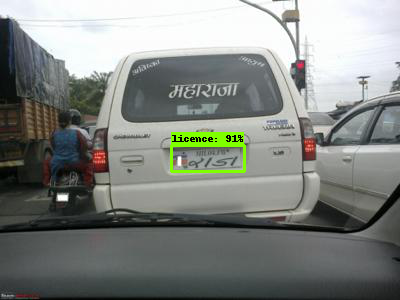

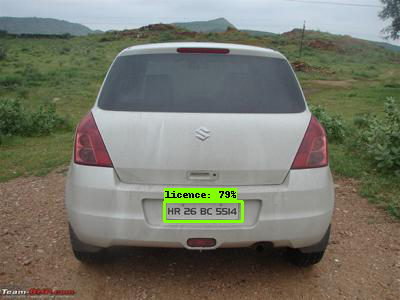

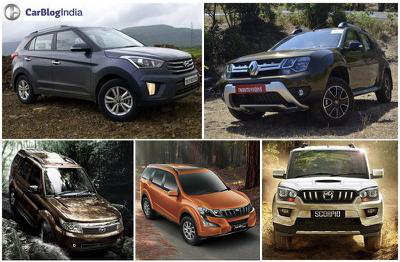

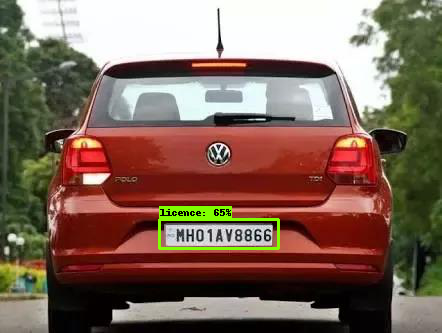

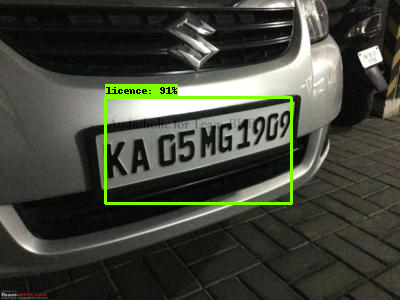

...

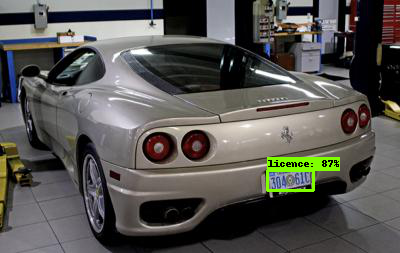

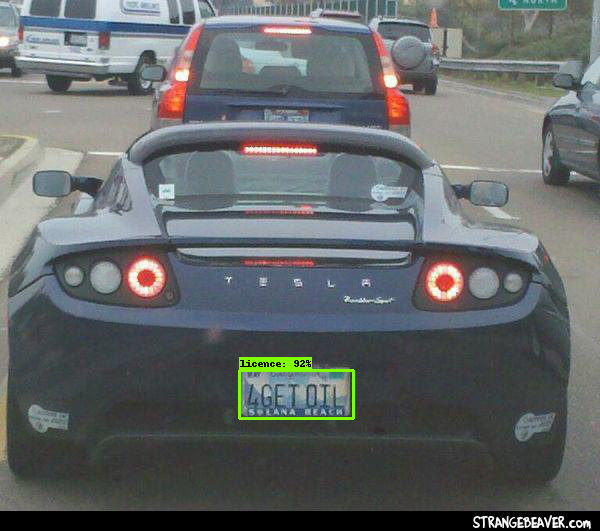

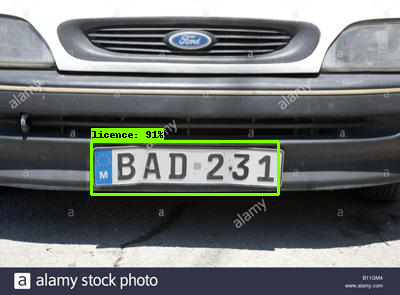

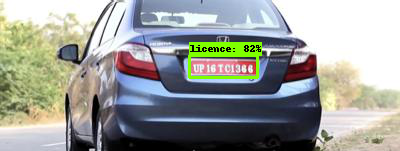

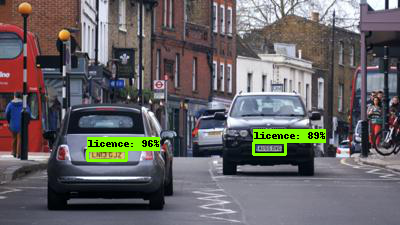

In [75]:
for image_path in glob.glob('car-plate-detection/test/*.jpg'):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=3)
  display(Image.fromarray(image_np))

# Test with custom url

In [91]:
# custom image urls from internet

image_urls = ['https://media.wired.com/photos/5dd438fa9ac14a0008116944/4:3/w_1876,h_1407,c_limit/Transpo-UberSelfDrivingVolvo--684693646.jpg',
              'https://i.pinimg.com/originals/a2/97/98/a29798e946c7d0a0e880130c8e7bc1d3.jpg',
              'https://images.squarespace-cdn.com/content/v1/5c981f3d0fb4450001fdde5d/1563727260863-E9JQC4UVO8IYCE6P19BO/cars+1.jpg']

In [87]:
from six.moves.urllib.request import urlopen
from six import BytesIO
from PIL import Image, ImageColor, ImageDraw , ImageFont , ImageOps
from IPython.display import display, Markdown ,clear_output
import tempfile

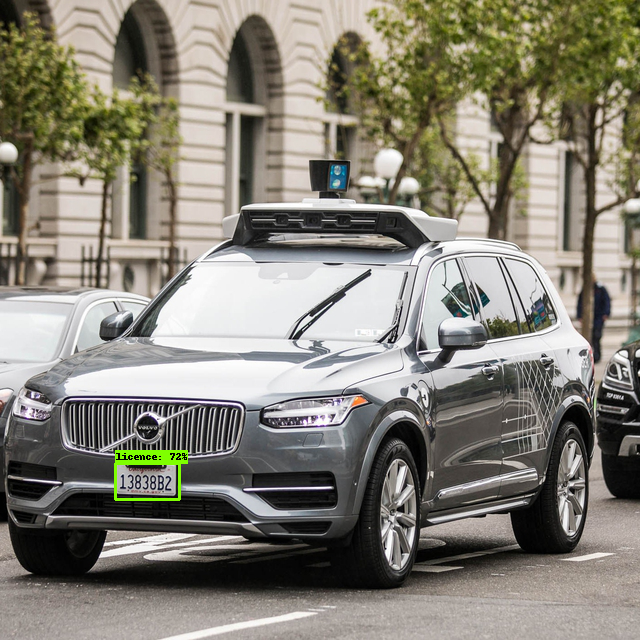

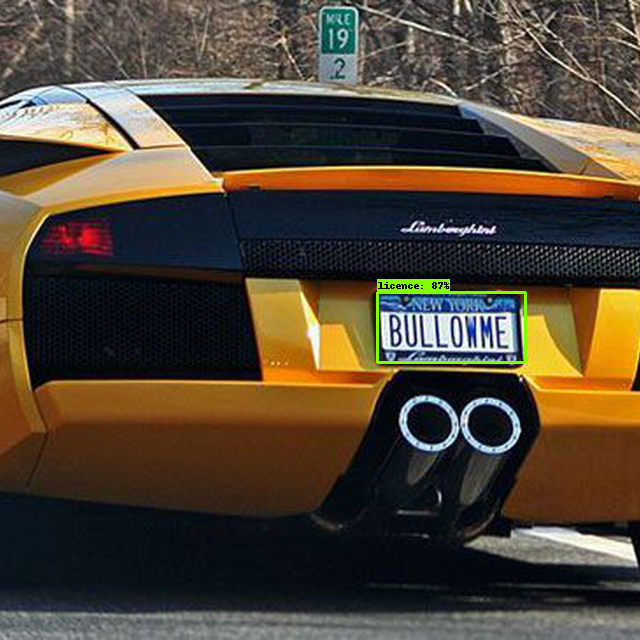

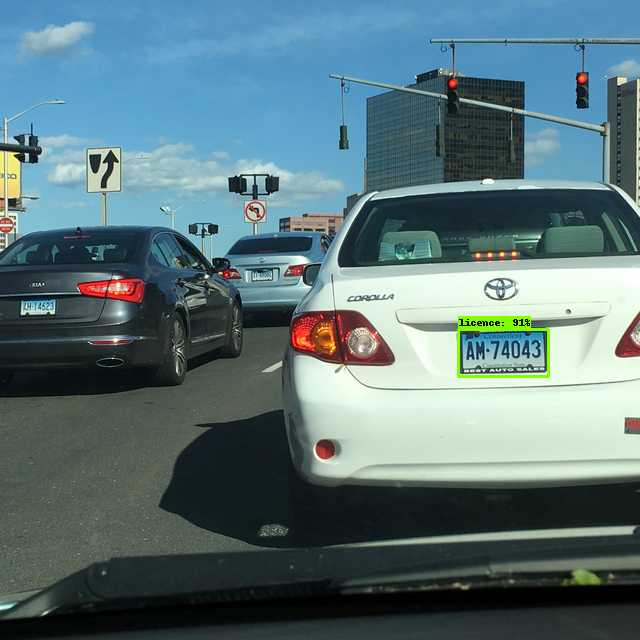

In [92]:
for index, url in enumerate(image_urls):
  try:
    response = urlopen(url)
    img = response.read()
    img = BytesIO(img)
    pil_image = Image.open(img)
    pil_image = ImageOps.fit(pil_image, (640, 640), Image.ANTIALIAS)
    pil_image_rgb= pil_image.convert("RGB")
    _, filename = tempfile.mkstemp(suffix=".jpg")
    pil_image_rgb.save(filename, format="JPEG", quality=100)
    image_np = load_image_into_numpy_array(filename)
    output_dict = run_inference_for_single_image(model, image_np)
    vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=3)
    display(Image.fromarray(image_np))
  except:
    pass

## This model works only for American Cars. Because of the dataset :')